In [2]:
from tabulate import tabulate
import matplotlib.pyplot as plt
import yfinance as yf
import matplotlib.dates as mdates
from datetime import datetime, timedelta

from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tools.sm_exceptions import ValueWarning, HessianInversionWarning, ConvergenceWarning
from statsmodels.tsa.api import VAR

import numpy as np
import seaborn as sns
import pandas as pd
from tqdm import tqdm


import warnings
warnings.simplefilter('ignore', ValueWarning)
warnings.simplefilter('ignore', HessianInversionWarning)
warnings.simplefilter('ignore', ConvergenceWarning)

sns.set_theme()


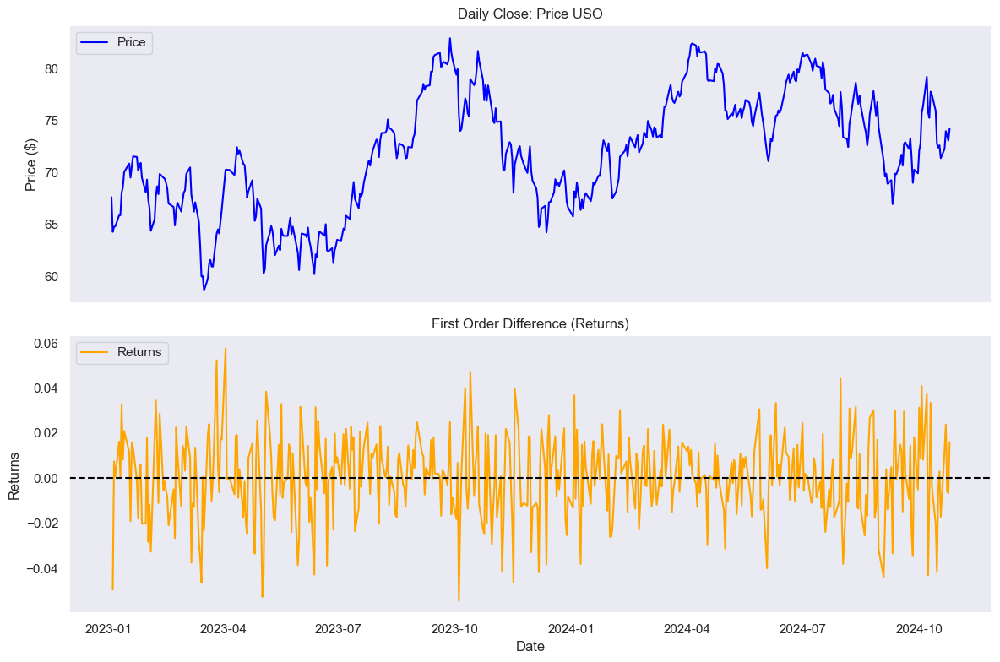

ADF Test Statistic: -13.407445621637153
p-value: 4.441529505224746e-25
Critical Values:
   1%: -3.445
   5%: -2.868
   10%: -2.570


In [3]:
#label our ticker and collect historical data
tickerSymbol = 'USO'

data = yf.Ticker(tickerSymbol)
#collect prices and returns
prices = data.history(start='2023-01-01', end='2024-10-26').Close
returns = prices.pct_change().dropna()
#plot results
fig, ax1 = plt.subplots(2, 1, figsize=(12,8), sharex = True)
ax1[0].plot(prices.index, prices, label='Price', color='blue')
ax1[0].set_title(f'Daily Close: Price {tickerSymbol}')
ax1[0].set_ylabel('Price ($)')
ax1[0].legend(loc='upper left')
ax1[0].grid()

ax1[1].plot(returns.index, returns, label='Returns', color='orange')
ax1[1].set_title('First Order Difference (Returns)')
ax1[1].set_ylabel('Returns')
ax1[1].set_xlabel('Date')
ax1[1].axhline(y=0, color = 'black', linestyle = "--")
ax1[1].legend(loc='upper left')
ax1[1].grid()

plt.tight_layout()
plt.show()


adf_result = adfuller(returns)
print("ADF Test Statistic:", adf_result[0])
print("p-value:", adf_result[1])
print("Critical Values:")
for key, value in adf_result[4].items():
    print(f"   {key}: {value:.3f}")

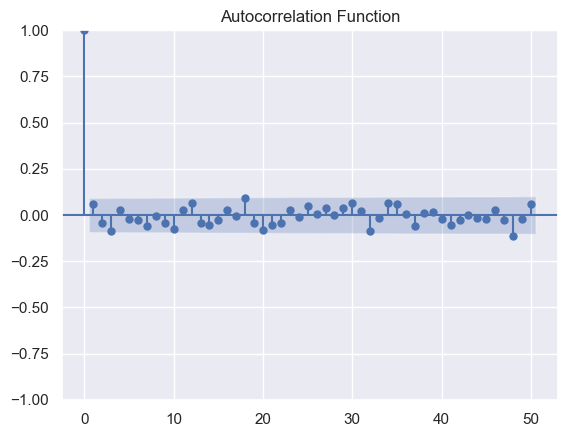

In [4]:
plot_acf(returns, lags=50)
plt.title('Autocorrelation Function')
plt.show()

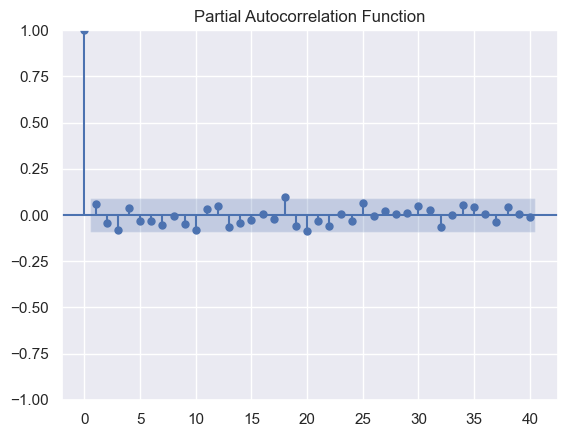

In [5]:
plot_pacf(returns, lags=40)
plt.title('Partial Autocorrelation Function')
plt.show();

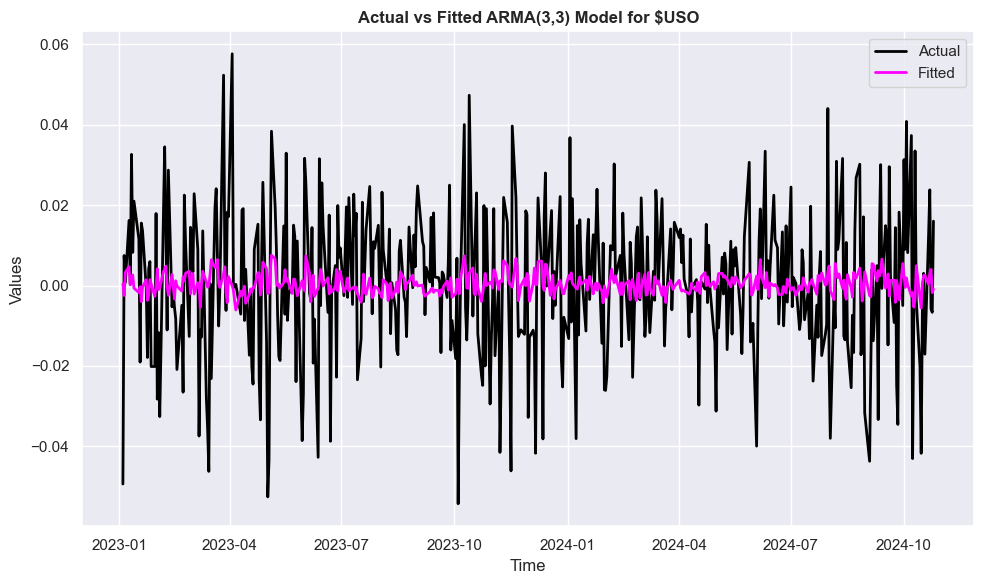

Akaike Information Criterion (AIC) = -2342.523472962165, Corrected (AICc) = -2342.2013253111586


In [6]:
p = 3  # AR order
q = 3  # MA order


#intended for cleaner visual, remove this for diagnostics

import warnings
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=ValueWarning)



# Fit the ARMA model
model = ARIMA(returns, order=(p, 0, q))
arma_model = model.fit()
fitted_values = arma_model.fittedvalues



# Plot the actual data and fitted values together
plt.figure(figsize=(10,6))
plt.plot(returns, label='Actual', color='black', lw=2)
plt.plot(fitted_values, label='Fitted', color='magenta', lw=2)
plt.title(f'Actual vs Fitted ARMA({p},{q}) Model for ${tickerSymbol}', fontweight = 'bold')
plt.xlabel('Time')
plt.ylabel('Values')

plt.legend()
plt.tight_layout()
plt.show()
#Fitting Criteria
print(f'Akaike Information Criterion (AIC) = {arma_model.aic}, Corrected (AICc) = {arma_model.aicc}')

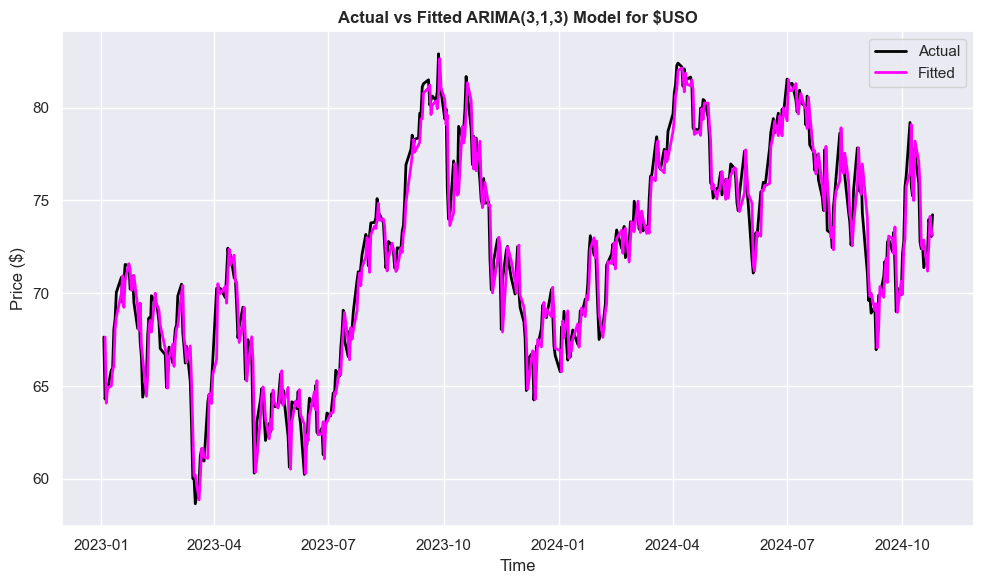

In [10]:
#Test our model
d=1

#intended for cleaner visual, remove this for diagnostics
import warnings
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=ValueWarning)



#fit ARIMA model
model2 = ARIMA(prices, order=(p, d, q))
arima_model = model2.fit()

#extract fitted values (in-sample predictions)
fitted_values = arima_model.fittedvalues

output_array = []
def backtest_bot(returns_thresh):
    #initialize dataframe
    TRADE_RESULTS = pd.DataFrame(
        {"TRADE" : [],
         "Date" : [],
         "Buy Price ($)" : [],
         "Sell Price ($)" : [],
         "Predicted Return (%)" : [],
         "Realised Return (%)" : [],
         "Trade Profit ($)" : [],
         "P/L ($)" : []
        }
    )
    total_profit = 0
    no_trades = 0
    #print(f'TRADING STRATEGY: BUY AND SELL FOLLOWING DAY WHEN PREDICTED RETURNS > {returns_thresh*100}% \n----------')
    for i in range(2, len(fitted_values)-1):
        #strategy goes here
        n = (fitted_values[i] - fitted_values[i-1])/fitted_values[i-1]
        if n > returns_thresh:
            #this executes the trade
            no_trades += 1
            trade_profit = prices[i] - prices[i-1]
            trade_returns = trade_profit/prices[i-1]
            total_profit += trade_profit
            #make a dictionary, for our pandas dataframe to take in
            trade_dict = {
                "TRADE" : int(no_trades),
                "Date" : prices.index[i-1],
                "Buy Price ($)" : np.round(prices[i-1],2),
                "Sell Price ($)" : np.round(prices[i],2),
                "Predicted Return (%)" : np.round(n*100,2),
                "Realised Return (%)" : np.round(trade_returns*100, 2),
                "Trade Profit ($)" : np.round(trade_profit,2),
                "P/L ($)" : np.round(total_profit,2)
            }
            #add the dictionary
            TRADE_RESULTS = pd.concat([TRADE_RESULTS, pd.DataFrame([trade_dict])], ignore_index=True)
    output_array.append(total_profit)
            #print(np.round(returns_thresh, 2))
            #print(output_array)
    

    
    
#format dates for a neater table
#TRADE_RESULTS['Date'] = pd.to_datetime(TRADE_RESULTS['Date'])
#TRADE_RESULTS['Date'] = TRADE_RESULTS['Date'].dt.strftime('%m/%d/%y')
#print(f'TOTAL PROFIT = ${np.round(total_profit,2)}')   
#temporarily moved, for MC plot  
#print our table
#print(tabulate(TRADE_RESULTS, headers="keys", tablefmt="pretty", showindex=False))
#plot our P/L       
#plt.figure(figsize=(10,6))
#plt.plot(TRADE_RESULTS["P/L ($)"], label='P/L ($)', color='green', lw=2)
#plt.title(f"Profit of our Trading Strategy, using ARIMA({p},{d},{q}), Buy Threshold= {returns_thresh*100}%", fontweight = 'bold')
#plt.xlabel('Trade Number')
#plt.axhline(y=0, color = 'red')
#plt.ylabel(f'($)')
#plt.legend()
#plt.tight_layout()
#plt.show()       
#backtest_bot(0.0)


# Plot the actual data and fitted values together
plt.figure(figsize=(10,6))
plt.plot(prices, label='Actual', color='black', lw=2)
plt.plot(fitted_values[1:], label='Fitted', color='magenta', lw=2)
plt.title(f'Actual vs Fitted ARIMA({p},{d},{q}) Model for ${tickerSymbol}', fontweight = 'bold')
plt.xlabel('Time')
plt.ylabel('Price ($)')
plt.legend()
plt.tight_layout()
plt.show()
#VAR()
#Multivariate GARCH
#INLA State Space Model


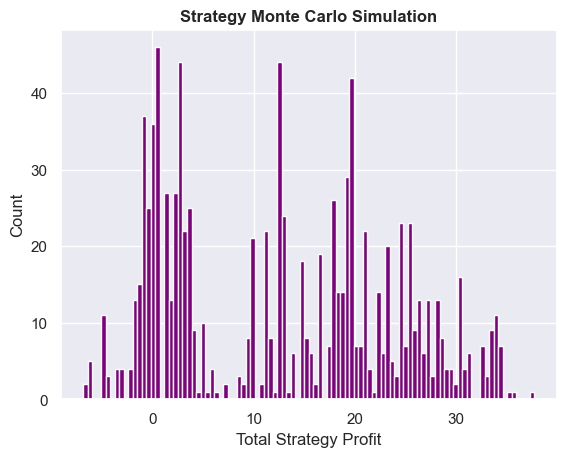

[[0,
  24.450016021728516,
  16.670024871826172,
  19.66000747680664,
  12.880050659179688,
  -0.6799812316894531,
  28.269996643066406,
  4.120025634765625,
  19.66000747680664,
  -0.1999969482421875,
  -5.979953765869141,
  19.030025482177734,
  12.63003921508789,
  18.850025177001953,
  2.490009307861328,
  18.770008087158203,
  1.2200126647949219,
  3.510040283203125,
  16.400054931640625,
  -0.6799812316894531,
  3.8900299072265625,
  18.030006408691406,
  23.36001968383789,
  2.6000213623046875,
  0.40000152587890625,
  4.770008087158203,
  18.30001449584961,
  1.9600105285644531,
  22.249988555908203,
  3.7000732421875,
  -1.5799903869628906,
  18.770008087158203,
  1.6300735473632812,
  16.630016326904297,
  14.670005798339844,
  -0.92999267578125,
  -0.0999908447265625,
  33.79999542236328,
  24.770023345947266,
  3.6000099182128906,
  12.6199951171875,
  -0.6799812316894531,
  18.850025177001953,
  -0.6799812316894531,
  3.8900299072265625,
  17.790027618408203,
  16.11001586

In [23]:
#Plan

#add mcmc visualisation, to illustrate need for GARCH+ARCH volatility modelling
#i want to simulate over a range of values in my argument, via monte carlo
#to do:
# - Make function, using bot, to output only total proft (easy)
# - simulate values through said function
# - tabulate values in array
# - plot via some library that can plot distributions


#troubleshooting
output_array = [0]
#step one
def profit_bot(sim_input):
    backtest_bot(sim_input)
    return output_array

#step two + three
sim_num = 1000
thresh_min = -0.05
thresh_max = 0.05
sim_values = np.random.uniform(thresh_min, thresh_max, sim_num)
MC_sim_results = [profit_bot(returns_thresh) for returns_thresh in sim_values]

#step four
plt.hist(MC_sim_results[0], bins=100, color = 'purple')
plt.xlabel('Total Strategy Profit')
plt.ylabel('Count')
plt.title('Strategy Monte Carlo Simulation', weight = 'bold')
plt.show()
MC_sim_results



c:\Users\oscar.smith\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


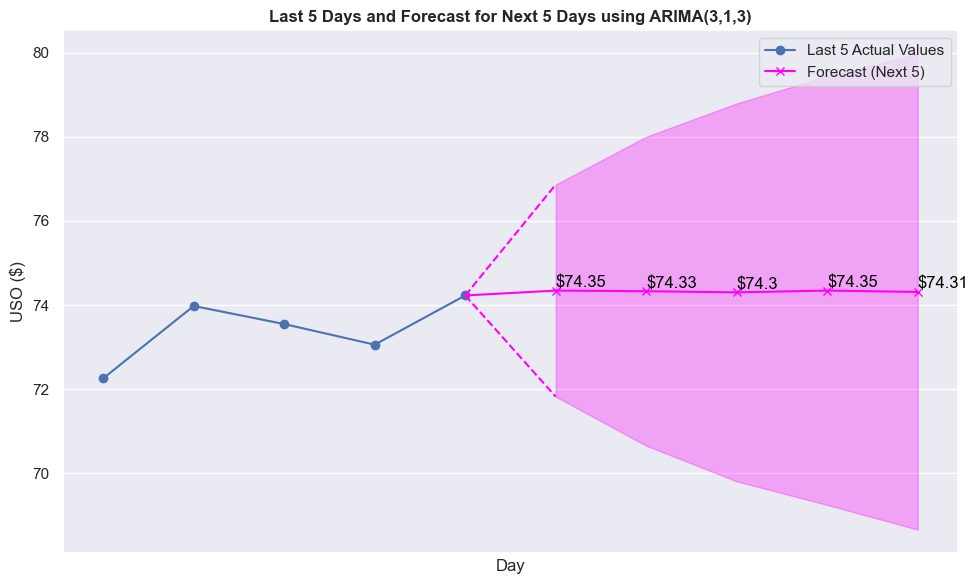

In [22]:
#########
#forecast the next 5 values
forecast_steps = 5
forecast_result = arima_model.get_forecast(steps=forecast_steps)
#extract predicted values and intervals
forecast_values = forecast_result.predicted_mean
confidence_intervals = forecast_result.conf_int()
#extract last 5 values
last_5_actual_values = prices[-5:]
#index future x values
future_index = np.arange(len(prices), len(prices) + forecast_steps)

plt.figure(figsize=(10, 6))
plt.plot(np.arange(len(prices) - 5, len(prices)), last_5_actual_values, label='Last 5 Actual Values', marker='o')
plt.plot(future_index, forecast_values, label='Forecast (Next 5)', marker='x', color='magenta')
plt.fill_between(future_index, confidence_intervals.iloc[:, 0], confidence_intervals.iloc[:, 1], color='magenta', alpha=0.3)
plt.plot([len(prices) - 1, len(prices)], [last_5_actual_values.iloc[-1], forecast_values.iloc[0]], color='magenta', linestyle='-')
plt.plot([len(prices) - 1, len(prices)], [last_5_actual_values.iloc[-1], confidence_intervals.iloc[0, 0]], color='magenta', linestyle='--')
plt.plot([len(prices) - 1, len(prices)], [last_5_actual_values.iloc[-1], confidence_intervals.iloc[0, 1]], color='magenta', linestyle='--')
plt.title(f'Last 5 Days and Forecast for Next 5 Days using ARIMA({p},{d},{q})', weight='bold')
plt.xlabel('Day')
plt.ylabel(f'{tickerSymbol} ($)')
plt.legend()
#Remove X label
plt.xticks([])

# Label each forecast value
for i in range(forecast_steps):
    plt.text(future_index[i], forecast_values.iloc[i], f'${np.round(forecast_values.iloc[i], 2)}', 
             horizontalalignment='left', verticalalignment='bottom', color='black')

# Show the plot
plt.tight_layout()
plt.show()

In [11]:
price = yf.download('SMCI')
price

[*********************100%***********************]  1 of 1 completed


,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2007-03-29,0.885000,0.931000,0.866000,0.876000,0.876000,60798000
2007-03-30,0.883000,0.900000,0.855000,0.899000,0.899000,4195000
2007-04-02,0.900000,1.059000,0.899000,1.038000,1.038000,7491000
2007-04-03,1.070000,1.166000,1.040000,1.058000,1.058000,8357000
2007-04-04,1.040000,1.099000,1.003000,1.016000,1.016000,3095000
...,...,...,...,...,...,...
2024-10-23,45.439999,46.139999,44.610001,45.360001,45.360001,24301000
2024-10-24,45.669998,47.240002,45.630001,46.230000,46.230000,23717700
2024-10-25,46.680000,48.400002,46.459999,47.270000,47.270000,32279200


3
